In [3]:
from pytrends.request import TrendReq
import json
import requests
import datetime as dt
import tweepy

# Google Trends

In [114]:
pytrend = TrendReq()
pytrend.trending_searches()

,0
0,Google Docs
1,iOS 16 release date
2,Drive
3,Elias Theodorou
4,Bills
5,Antonio Brown
6,Dallas Cowboys
7,NFL
8,NFL scores
9,Packers


In [132]:
query = 'Queen Elizabeth'
pytrend = TrendReq()
pytrend.build_payload(kw_list=[query])
trending = pytrend.trending_searches()

In [133]:
for item in trending.iteritems():
    print(item[1][0])

Armenia


In [134]:
for trend in trending.iterrows():
    print(trend[1][0])

Armenia
PnB Rock
Emmys 2022
Google Docs
Google Maps
iOS 16
Maps
LinkedIn
Outlook
Zoom
Zendaya
Dow Jones
Dopesick
Fidelity
Elias Theodorou
Queen Elizabeth children
Drive
Abbott Elementary
Social Security
Britney Spears


In [152]:
# Historical Interest
query = 'Citizen Kane'
pytrend = TrendReq()
pytrend.build_payload(kw_list=[query])

historical = pytrend.interest_over_time()[query]
historical

date
2017-09-17    24
2017-09-24    23
2017-10-01    26
2017-10-08    24
2017-10-15    26
              ..
2022-08-07    19
2022-08-14    17
2022-08-21    17
2022-08-28    18
2022-09-04    15
Name: Citizen Kane, Length: 260, dtype: int64

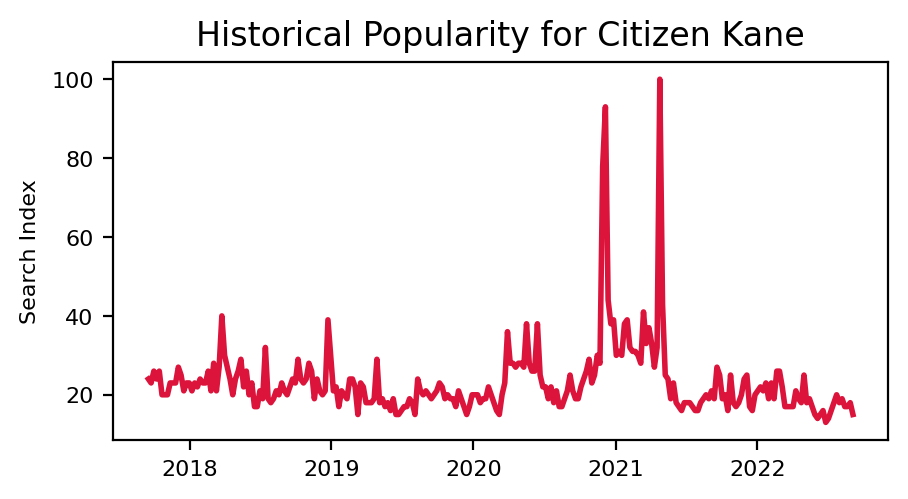

In [170]:
import pandas as pd
import numpy as np
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(5,2.5), dpi=200)
plt.title(f'Historical Popularity for {query}')
plt.yticks(fontsize=8)
plt.xticks(fontsize=8)
plt.ylabel('Search Index', fontsize=8)
plt.plot(historical.index, historical.values, c='crimson', linewidth=2)
plt.savefig('static/img/historical.jpg', bbox_inches = 'tight')

In [154]:
# Interest by Region
regions = pytrend.interest_by_region()
regions = regions.sort_values(by=query, ascending=False)
regions = regions[0:10]
regions

,Citizen Kane
geoName,
United States,100
Belgium,96
Ireland,92
Canada,89
Sweden,88
United Kingdom,79
Australia,71
New Zealand,63
Denmark,62


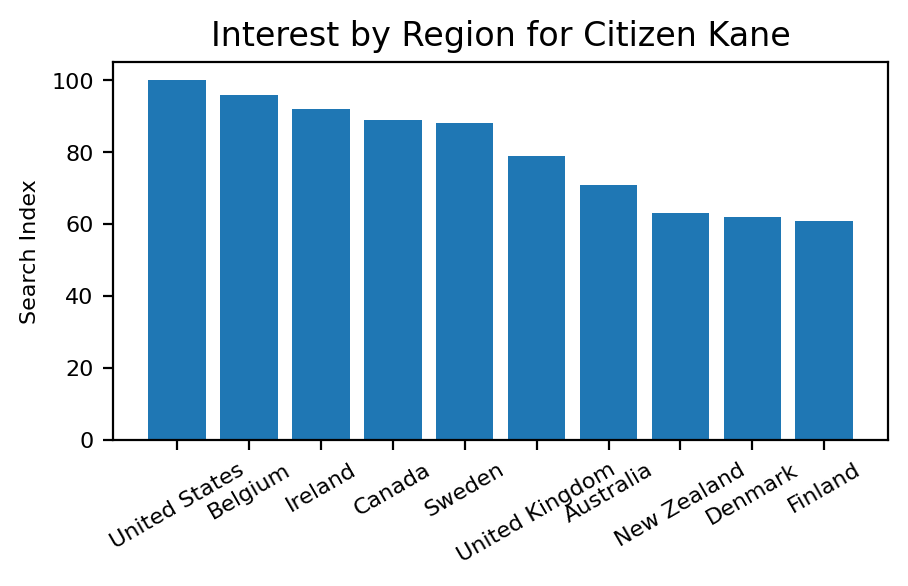

In [169]:
plt.figure(figsize=(5,2.5), dpi=200)
plt.xticks(fontsize=8, rotation=30)
plt.yticks(fontsize=8)
plt.title(f'Interest by Region for {query}')
plt.ylabel('Search Index', fontsize=8)

plt.bar(regions.index, regions[query])
plt.savefig('static/img/regions.jpg', bbox_inches = 'tight')

In [50]:
# Related Queries
related = pytrend.related_queries()
related = related[query]['top']
related

,query,value
0,the queen elizabeth,100
1,the queen,100
2,queen elizabeth nail polish,62
3,elizabeth ii,57
4,queen elizabeth ii,57
5,queen elizabeth age,27
6,how old is queen elizabeth,25
7,queen elizabeth nail color,24
8,queen elizabeth nail polish color,22
9,queen elizabeth hospital,21


In [178]:
for i in related.iterrows():
    print(i[1]['value'])

100
100
62
57
57
27
25
24
22
21
19
18
15
15
15
15
14
14
14
13
12
12
12
11
11


# News API

In [5]:
query = 'Queen Elizabeth'

In [6]:
# Read in credential string and save as a dictionary
with open('../../../../Dropbox/100DaysOfCodePRIVATE/Day95Creds.json') as file:
    creds = json.loads(file.read())

NEWS_ENDPOINT = "https://newsapi.org/v2/everything"
NEWS_KEY = creds['NEWS_API']

# STEP 2: Fetch top three articles that mention the query
# Use https://newsapi.org/docs/endpoints/everything

today = dt.datetime.today().strftime('%Y-%m-%d')
news_url = f'{NEWS_ENDPOINT}?q={query.lower()}&from={today}&sortBy=publishedAt&apiKey={NEWS_KEY}&language=en'
response = requests.get(news_url)

In [9]:
# Print status, return data
print('News response status code:', response.status_code)
response.raise_for_status()
news_data = response.json()
news = news_data['articles']

# Save select info from top five articles
top_five_articles = []
for i in range(0, 5):
    article_tuple = (news[i]['title'], news[i]['url'], news[i]['description'])
    top_five_articles.append(article_tuple)

News response status code: 200


In [10]:
top_five_articles

[('Where Will The Queen Elizabeth Be Buried? Everything To Know About Monarch’s Final Resting Place',
  'https://hollywoodlife.com/feature/where-will-the-queen-elizabeth-be-buried-4842081/',
  "Queen Elizabeth II's funeral is set to take place on Sept. 19, after the 10 day mourning period. Find out more about the historical location where her body will be laid to rest."),
 ("'Visionary project': New public square named after Queen to be built in Sydney's CBD",
  'https://www.abc.net.au/news/2022-09-14/queen-elizabeth-2-square-sydney-bd/101437066',
  'Anthony Albanese calls "visionary"\xa0project set to link the city to parklands "an appropriate and fitting tribute" to the late monarch.'),
 ("Petition launched for annual 'Queen Elizabeth Day' bank holiday",
  'https://www.dailymail.co.uk/news/article-11209563/Petition-launched-annual-Queen-Elizabeth-Day-bank-holiday.html',
  'The petition was started by John Harris on Change.org and proposes that September 8, the day she died, is made i

# Twitter API

In [74]:
# API keys that yous saved earlier
api_key = creds['TWITTER_KEY']
api_secrets = creds['TWITTER_SECRET']
access_token = creds['ACCESS_TOKEN']
access_secret = creds['ACCESS_SECRET']

# Authenticate to Twitter
auth = tweepy.OAuthHandler(api_key,api_secrets)
auth.set_access_token(access_token,access_secret)

api = tweepy.API(auth)

try:
    api.verify_credentials()
    print('Successful Authentication')
except:
    print('Failed authentication')

Successful Authentication


In [78]:
query = 'python'
max_tweets = 20
searched_tweets = [status for status in tweepy.Cursor(api.search_tweets, q=query).items(max_tweets)]
searched_tweets

[Status(_api=<tweepy.api.API object at 0x7fd3df87abe0>, _json={'created_at': 'Mon Sep 12 15:16:11 +0000 2022', 'id': 1569344127614984192, 'id_str': '1569344127614984192', 'text': 'RT @ingliguori: #Infographic: #SQL Query Execution Order \nVia @ingliguori\n#ArtificialIntelligence #AI #ML #MachineLearning #DataScientists…', 'truncated': False, 'entities': {'hashtags': [{'text': 'Infographic', 'indices': [16, 28]}, {'text': 'SQL', 'indices': [30, 34]}, {'text': 'ArtificialIntelligence', 'indices': [74, 97]}, {'text': 'AI', 'indices': [98, 101]}, {'text': 'ML', 'indices': [102, 105]}, {'text': 'MachineLearning', 'indices': [106, 122]}, {'text': 'DataScientists', 'indices': [123, 138]}], 'symbols': [], 'user_mentions': [{'screen_name': 'ingliguori', 'name': 'Giuliano Liguori', 'id': 836510570, 'id_str': '836510570', 'indices': [3, 14]}, {'screen_name': 'ingliguori', 'name': 'Giuliano Liguori', 'id': 836510570, 'id_str': '836510570', 'indices': [62, 73]}], 'urls': []}, 'metadata': {'iso_lang

In [89]:
i = 0
t = searched_tweets[i]._json
t

{'created_at': 'Mon Sep 12 15:16:11 +0000 2022',
 'id': 1569344127614984192,
 'id_str': '1569344127614984192',
 'text': 'RT @ingliguori: #Infographic: #SQL Query Execution Order \nVia @ingliguori\n#ArtificialIntelligence #AI #ML #MachineLearning #DataScientists…',
 'truncated': False,
 'entities': {'hashtags': [{'text': 'Infographic', 'indices': [16, 28]},
   {'text': 'SQL', 'indices': [30, 34]},
   {'text': 'ArtificialIntelligence', 'indices': [74, 97]},
   {'text': 'AI', 'indices': [98, 101]},
   {'text': 'ML', 'indices': [102, 105]},
   {'text': 'MachineLearning', 'indices': [106, 122]},
   {'text': 'DataScientists', 'indices': [123, 138]}],
  'symbols': [],
  'user_mentions': [{'screen_name': 'ingliguori',
    'name': 'Giuliano Liguori',
    'id': 836510570,
    'id_str': '836510570',
    'indices': [3, 14]},
   {'screen_name': 'ingliguori',
    'name': 'Giuliano Liguori',
    'id': 836510570,
    'id_str': '836510570',
    'indices': [62, 73]}],
  'urls': []},
 'metadata': {'iso_l

In [101]:
t['text']
t['created_at']
t['user']['screen_name']
t['user']['name']
t['user']['location']
f"https://twitter.com/{t['user']['screen_name']}/status/{t['id_str']}"

'https://twitter.com/vindhizo/status/1569344127614984192'